# Import Libraries

In [1]:
import os
import shutil
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image
from tensorflow.keras import layers
from keras.models import Model
import random as rn
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
import matplotlib.cm as cm
import cv2
import glob

In [2]:
dataset_path = "/Users/marysia/Downloads/chest_xray_2"
train_dir = os.path.join(dataset_path, 'train')
test_dir = os.path.join(dataset_path, 'test')
val_dir = os.path.join(dataset_path, 'val')

train_pneumonia_dir = os.path.join(train_dir, 'PNEUMONIA/')  # directory with our training Pneumonia pictures
train_normal_dir = os.path.join(train_dir, 'NORMAL/')  # directory with our training Normal pictures
test_pneumonia_dir = os.path.join(test_dir, 'PNEUMONIA/')  # directory with our validation Pneumonia pictures
test_normal_dir = os.path.join(test_dir, 'NORMAL/')  # directory with our validation Normal pictures
val_pneumonia_dir = os.path.join(val_dir, 'PNEUMONIA/')
val_normal_dir = os.path.join(val_dir, 'NORMAL/')

train_normal = os.listdir(train_normal_dir)
train_pneu = os.listdir(train_normal_dir)
test_normal = os.listdir(test_normal_dir)
test_pneu = os.listdir(test_pneumonia_dir)
val_normal = os.listdir(val_normal_dir)
val_pneu = os.listdir(val_pneumonia_dir)

# find all files, our files has extension jpeg
train_norm = glob.glob(train_normal_dir + '*jpeg')
train_pneu = glob.glob(train_pneumonia_dir + '*jpeg')
 
test_norm = glob.glob(test_normal_dir + '*jpeg')
test_pneu = glob.glob(test_pneumonia_dir + '*jpeg')
 
val_norm = glob.glob(val_normal_dir + '*jpeg')
val_pneu = glob.glob(val_pneumonia_dir + '*jpeg')

In [3]:
list_total = [] #list with links to all files.
list_total_norm = []
list_total_pneu = []
for x in train_norm + test_norm+ val_norm:
    list_total.append([x, 0])
    list_total_norm.append([x, 0])
    
for x in train_pneu + test_pneu + val_pneu:
    list_total.append([x, 1])
    list_total_pneu.append([x, 0])

In [4]:
"""Read data_set"""

import h5py

f = h5py.File('DataSet_Pneumonia', 'r')

X_new = f['X_train']
X_train = X_new[::]
y_new = f['y_train']
y_train = y_new[::]

X_new = f['X_train']
X_train = X_new[::]
y_new = f['y_train']
y_train = y_new[::]

X_new = f['X_train']
X_train = X_new[::]
y_new = f['y_train']
y_train = y_new[::]

# Function

In [5]:
def get_index_by_layer_name(model, layer_name):
  for index, layer in enumerate(model.layers):
      if layer.name == layer_name:
          return index

# Intermediate activations
Visualizing intermediate activations refers to the process of inspecting the output of each layer of a neural network to gain insight into how the network is processing the input.

In [6]:
images_per_row = 16 # how many images per row to show

In [195]:
def get_layer_names_and_outputs (model):
  layer_outputs = []
  layer_names = []
  for layer in model.layers:
      if isinstance(layer, (layers.Conv2D, layers.MaxPooling2D)):
          layer_outputs.append(layer.output)
          layer_names.append(layer.name)
  return layer_names, layer_outputs

def print_intermediate_activations(layer_names, activations, how_many_layers_to_show=None, how_many_layers_to_skip=0):
  layer_names = layer_names[how_many_layers_to_skip:]
  activations = activations[how_many_layers_to_skip:]

  count_layers = 0
  for layer_name, layer_activation in zip(layer_names, activations):

      count_layers += 1
      if how_many_layers_to_show: # not None
        if count_layers > how_many_layers_to_show:
          break

      n_features = layer_activation.shape[-1] # Number of features in the feature map

      size = layer_activation.shape[1] # The feature map has shape (1, image_height, image_width, n_features), image_height = image_width
      n_cols = n_features // images_per_row
      display_grid = np.zeros((size * n_cols, images_per_row * size))

      for col in range(n_cols):
          for row in range(images_per_row):
              channel_image = layer_activation[0,:, :, col * images_per_row + row]
              channel_image -= channel_image.mean() # remove the mean
              channel_image /= channel_image.std() # divide by the standard deviation
              channel_image *= 64 
              # now we can sum 128 to get the interval [0, 255]
              channel_image += 128
              channel_image = np.clip(channel_image, 0, 255).astype('uint8')
              display_grid[col * size : (col + 1) * size, row * size : (row + 1) * size] = channel_image

      # Display the grid
      scale = 1. / size
      plt.figure(figsize=(scale * display_grid.shape[1],
                          scale * display_grid.shape[0]))
      plt.title(layer_name)
      plt.grid(False)
      plt.imshow(display_grid, aspect='auto', cmap='gray')
      
  plt.show()

# Visualizing intermediate activations

## CNN from scratch

In [8]:
img_path = '/Users/marysia/Downloads/chest_xray_2/val/PNEUMONIA/person1952_bacteria_4883.jpeg'

In [9]:
# Preprocess the image into a 4D tensor 
image_height = 256
image_width = 256
img = image.load_img(img_path, target_size=(image_height, image_width))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0) # add batch dimension

# Its shape is (1, image_height, image_width, 3)
print(img_tensor.shape)

(1, 256, 256, 3)


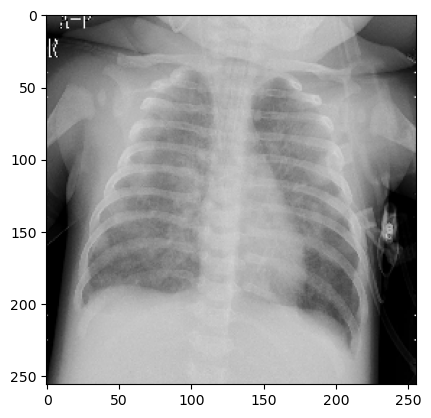

In [10]:
plt.imshow(img_tensor[0].astype('uint8'))
plt.show()

In [11]:
model = tf.keras.models.load_model('/Users/marysia/Desktop/Deep_learning/models/pneumonia_models')
model.summary() 

Model: "model_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_9 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 rescaling_8 (Rescaling)     (None, 256, 256, 3)       0         
                                                                 
 conv2d_37 (Conv2D)          (None, 254, 254, 32)      896       
                                                                 
 max_pooling2d_32 (MaxPoolin  (None, 127, 127, 32)     0         
 g2D)                                                            
                                                                 
 conv2d_38 (Conv2D)          (None, 125, 125, 64)      18496     
                                                                 
 max_pooling2d_33 (MaxPoolin  (None, 62, 62, 64)       0         
 g2D)                                                      

In [12]:
layer_names, layer_outputs = get_layer_names_and_outputs(model)
activation_model = keras.Model(inputs=model.input, outputs=layer_outputs) # one input and multiple outputs

In [13]:
activations = activation_model.predict(img_tensor)
for out in activations:
  print(out.shape)

2023-01-27 21:16:41.663231: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


1/1 [==============================] - 0s 275ms/step
(1, 254, 254, 32)
(1, 127, 127, 32)
(1, 125, 125, 64)
(1, 62, 62, 64)
(1, 60, 60, 128)
(1, 30, 30, 128)
(1, 28, 28, 256)
(1, 14, 14, 256)
(1, 12, 12, 256)


**Feature maps**

/var/folders/bl/bmspcss576x1_nsjjqdhbjvw0000gn/T/ipykernel_93469/2475066085.py:36: RuntimeWarning: invalid value encountered in divide
  channel_image /= channel_image.std() # divide by the standard deviation


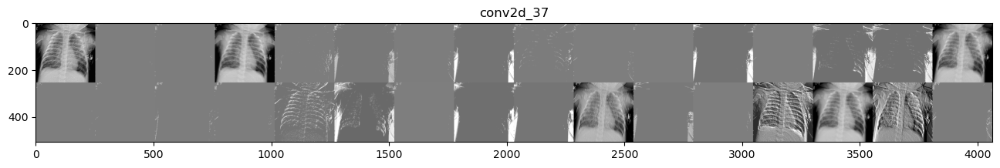

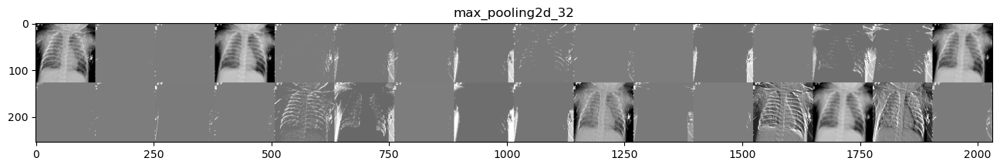

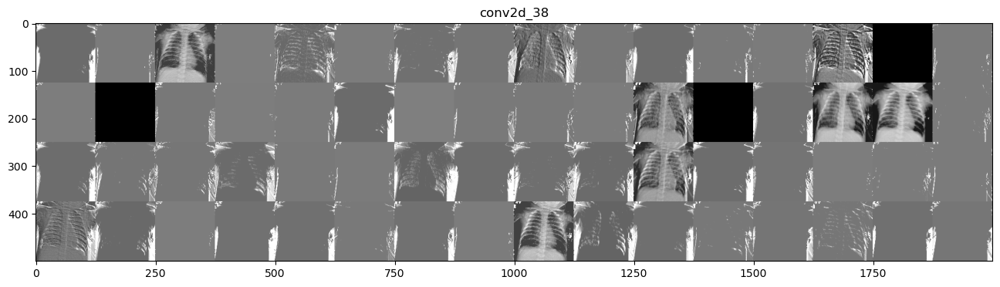

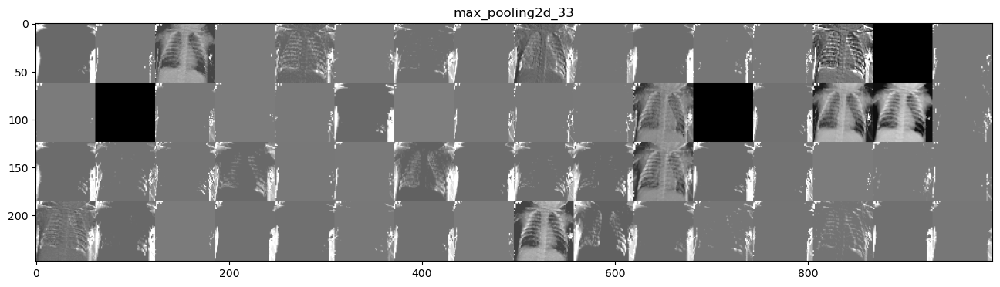

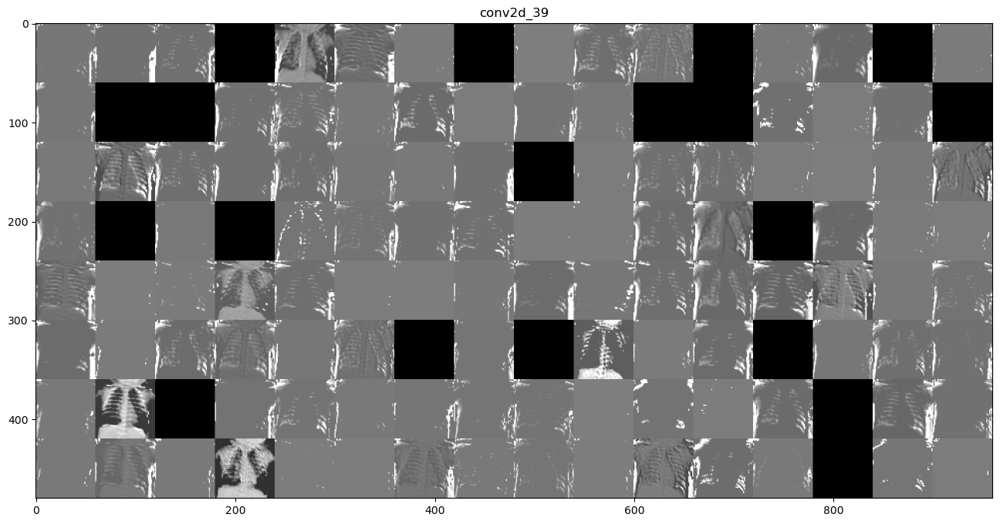

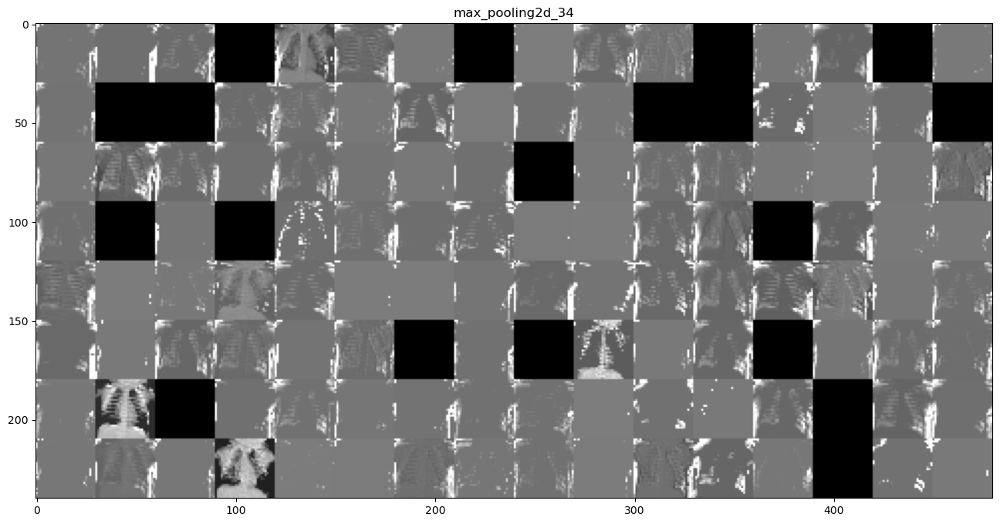

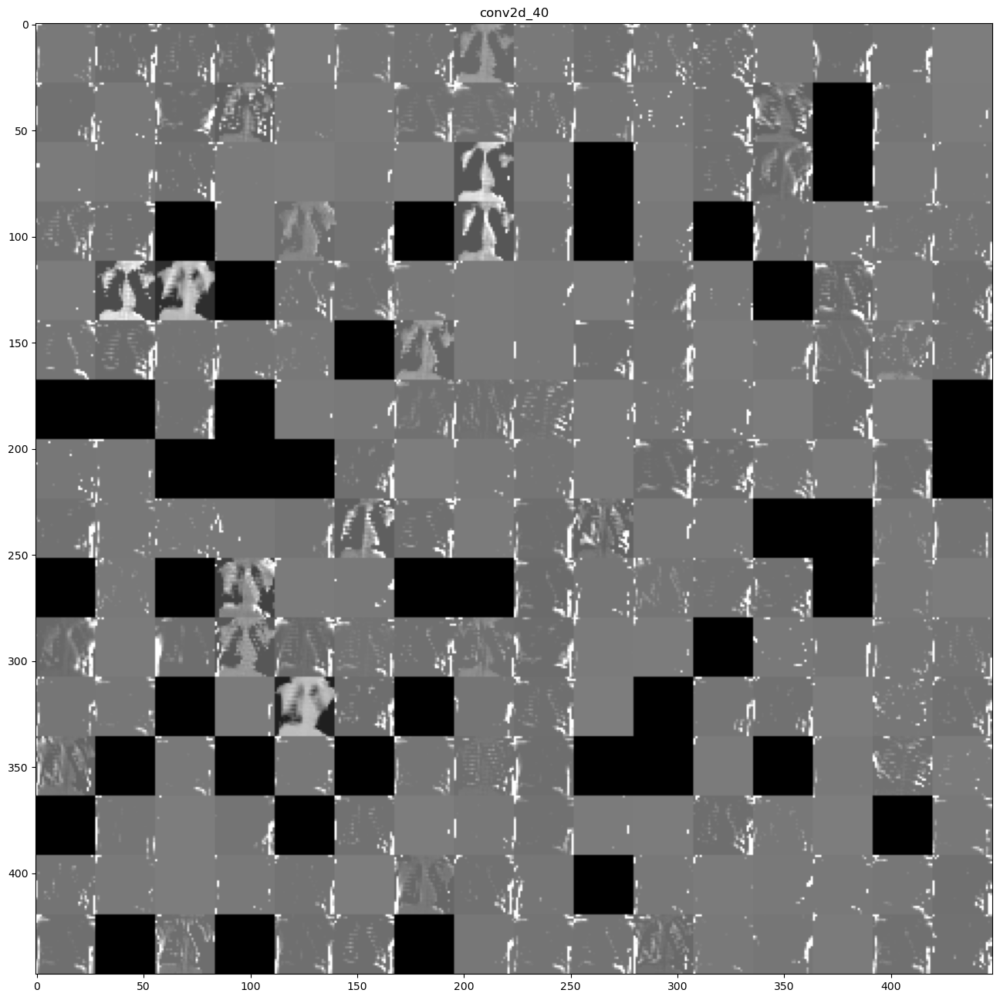

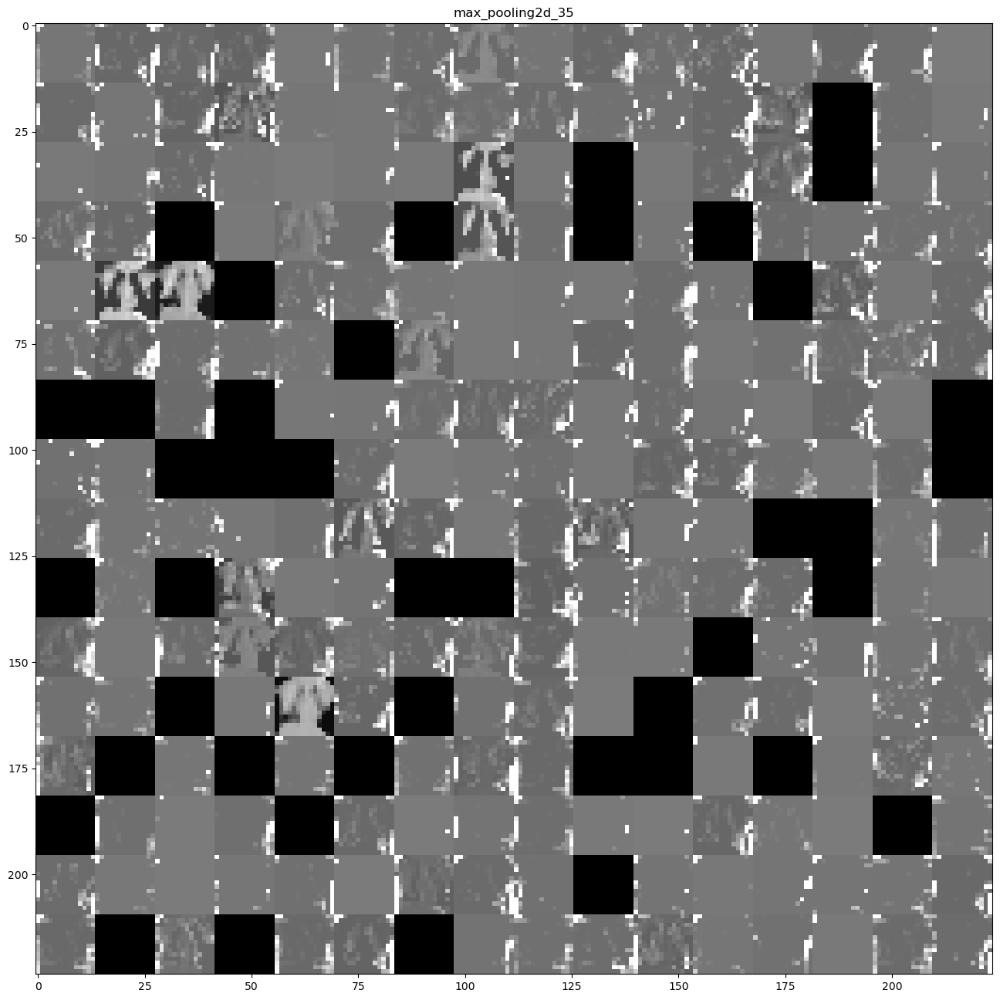

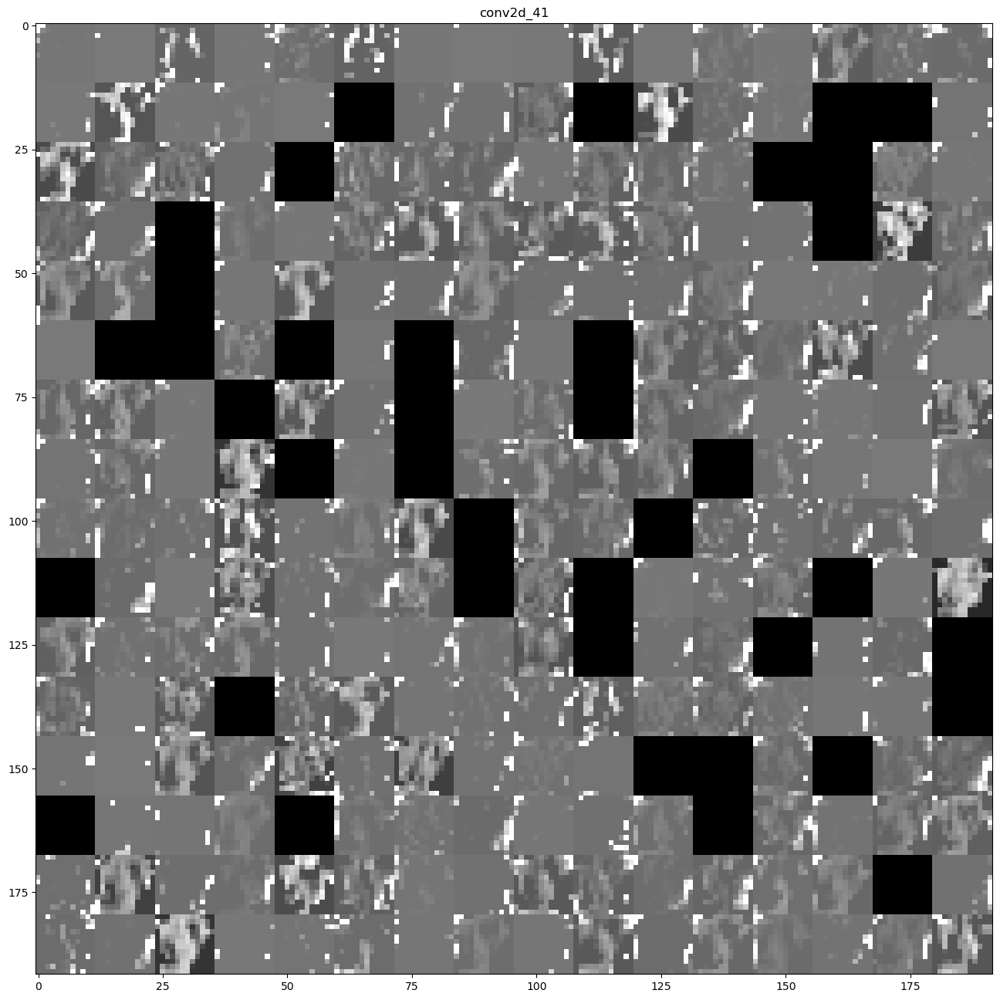

In [14]:
print_intermediate_activations(layer_names, activations)

## VGG16

In [15]:
vgg_model = tf.keras.models.load_model('training_1/cp.ckpt')
vgg_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 sequential (Sequential)     (None, 256, 256, 3)       0         
                                                                 
 tf.__operators__.getitem (S  (None, 256, 256, 3)      0         
 licingOpLambda)                                                 
                                                                 
 tf.nn.bias_add (TFOpLambda)  (None, 256, 256, 3)      0         
                                                                 
 vgg16 (Functional)          (None, 8, 8, 512)         14714688  
                                                                 
 flatten (Flatten)           (None, 32768)             0         
                                                             

In [16]:
vgg16_model = vgg_model.get_layer('vgg16')

In [17]:
vgg16_model.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 256, 256, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 256, 256, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 128, 128, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 128, 128, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 128, 128, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 64, 64, 128)       0     

In order to extract the feature maps I want to look at a model that takes batches of images as input, and outputs the activations of all convolution and pooling layers. 

In [18]:
layer_names, layer_outputs = get_layer_names_and_outputs(vgg16_model)
print('How many layers: ', len(layer_names))
print(layer_names)
print(layer_outputs)
activation_model = keras.Model(inputs=vgg16_model.input, outputs=layer_outputs) # one input and multiple output

How many layers:  18
['block1_conv1', 'block1_conv2', 'block1_pool', 'block2_conv1', 'block2_conv2', 'block2_pool', 'block3_conv1', 'block3_conv2', 'block3_conv3', 'block3_pool', 'block4_conv1', 'block4_conv2', 'block4_conv3', 'block4_pool', 'block5_conv1', 'block5_conv2', 'block5_conv3', 'block5_pool']
[<KerasTensor: shape=(None, 256, 256, 64) dtype=float32 (created by layer 'block1_conv1')>, <KerasTensor: shape=(None, 256, 256, 64) dtype=float32 (created by layer 'block1_conv2')>, <KerasTensor: shape=(None, 128, 128, 64) dtype=float32 (created by layer 'block1_pool')>, <KerasTensor: shape=(None, 128, 128, 128) dtype=float32 (created by layer 'block2_conv1')>, <KerasTensor: shape=(None, 128, 128, 128) dtype=float32 (created by layer 'block2_conv2')>, <KerasTensor: shape=(None, 64, 64, 128) dtype=float32 (created by layer 'block2_pool')>, <KerasTensor: shape=(None, 64, 64, 256) dtype=float32 (created by layer 'block3_conv1')>, <KerasTensor: shape=(None, 64, 64, 256) dtype=float32 (crea

In [19]:
activations = activation_model.predict(img_tensor)
for out in activations:
  print(out.shape)

1/1 [==============================] - 0s 421ms/step
(1, 256, 256, 64)
(1, 256, 256, 64)
(1, 128, 128, 64)
(1, 128, 128, 128)
(1, 128, 128, 128)
(1, 64, 64, 128)
(1, 64, 64, 256)
(1, 64, 64, 256)
(1, 64, 64, 256)
(1, 32, 32, 256)
(1, 32, 32, 512)
(1, 32, 32, 512)
(1, 32, 32, 512)
(1, 16, 16, 512)
(1, 16, 16, 512)
(1, 16, 16, 512)
(1, 16, 16, 512)
(1, 8, 8, 512)


**Feature maps**

/var/folders/bl/bmspcss576x1_nsjjqdhbjvw0000gn/T/ipykernel_93469/2475066085.py:36: RuntimeWarning: invalid value encountered in divide
  channel_image /= channel_image.std() # divide by the standard deviation


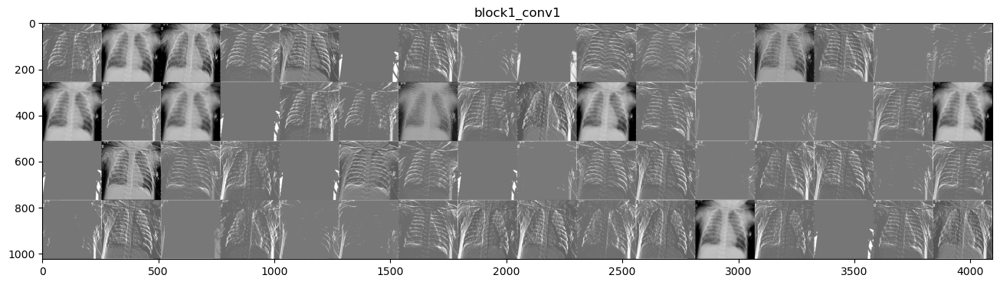

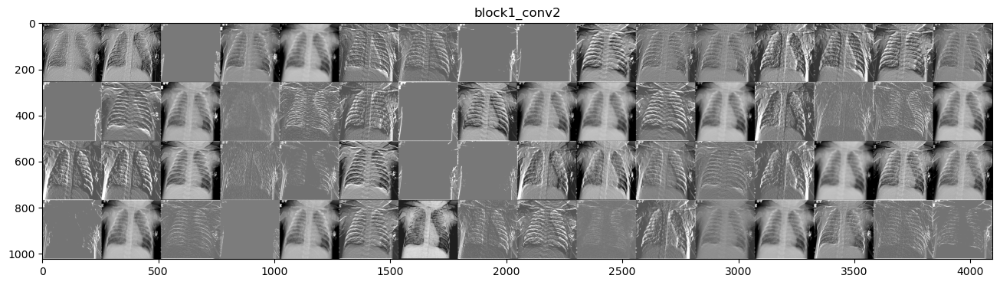

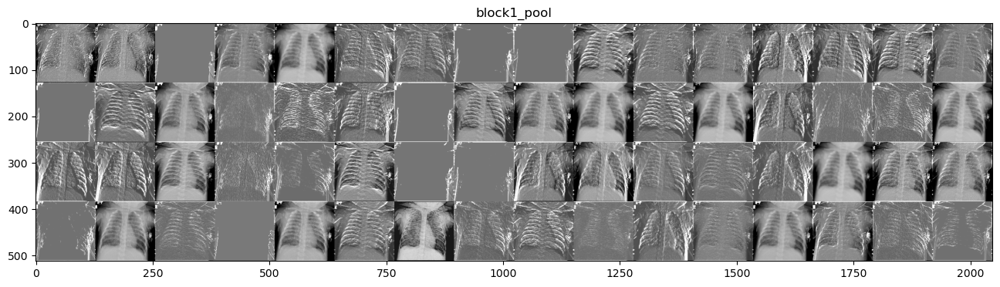

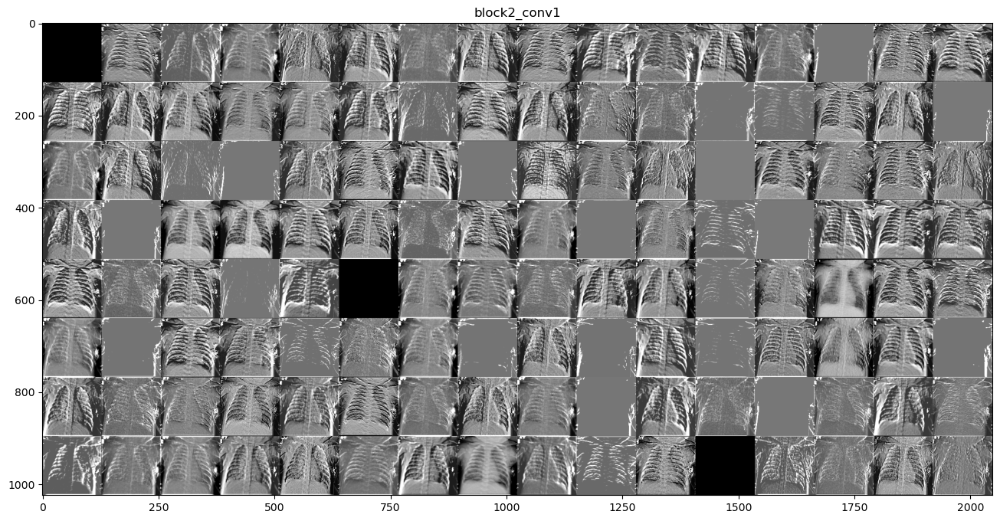

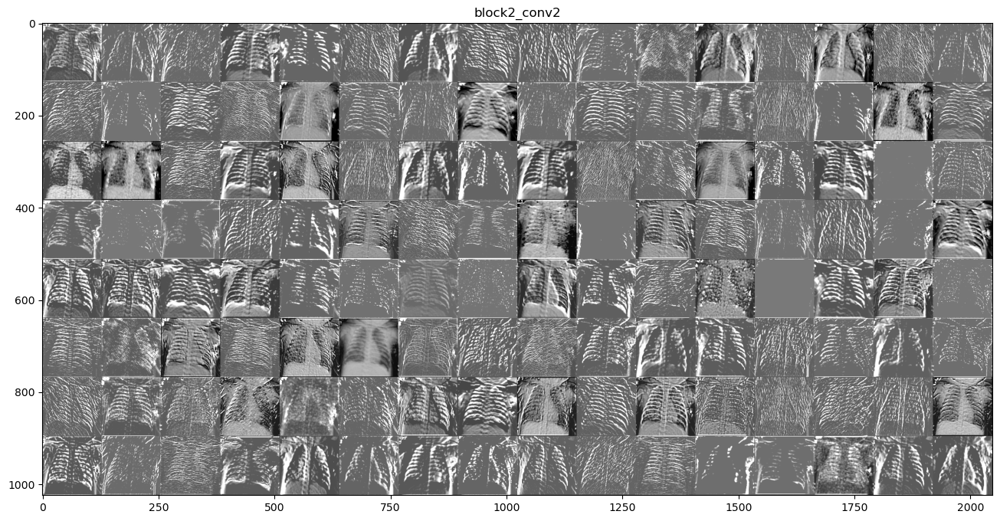

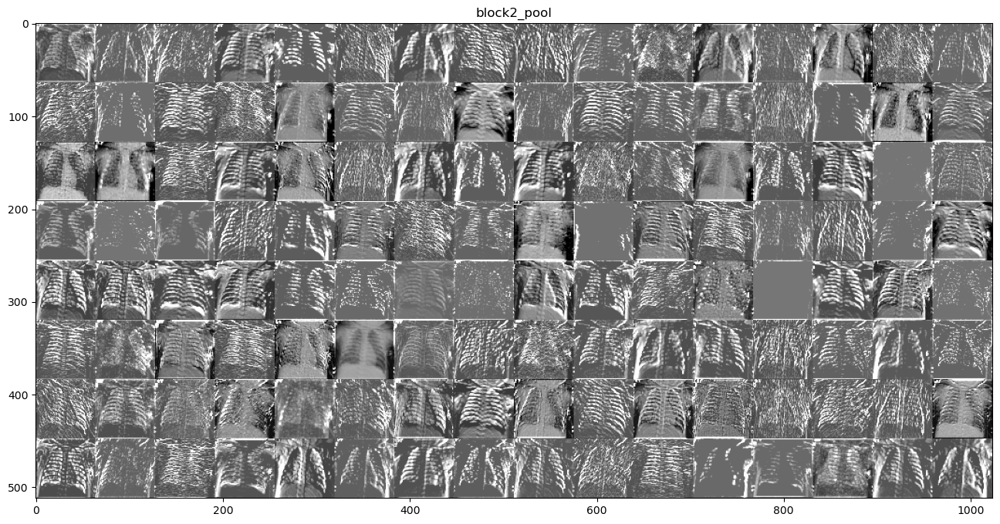

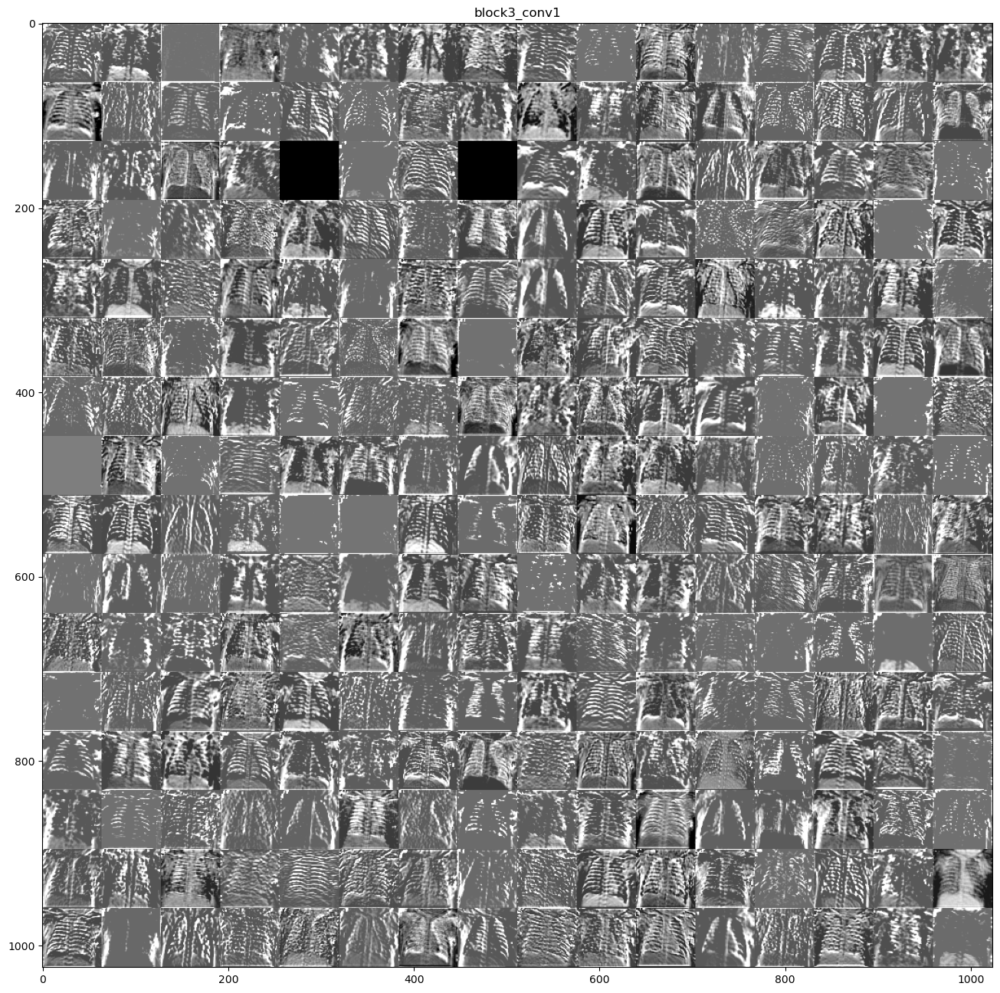

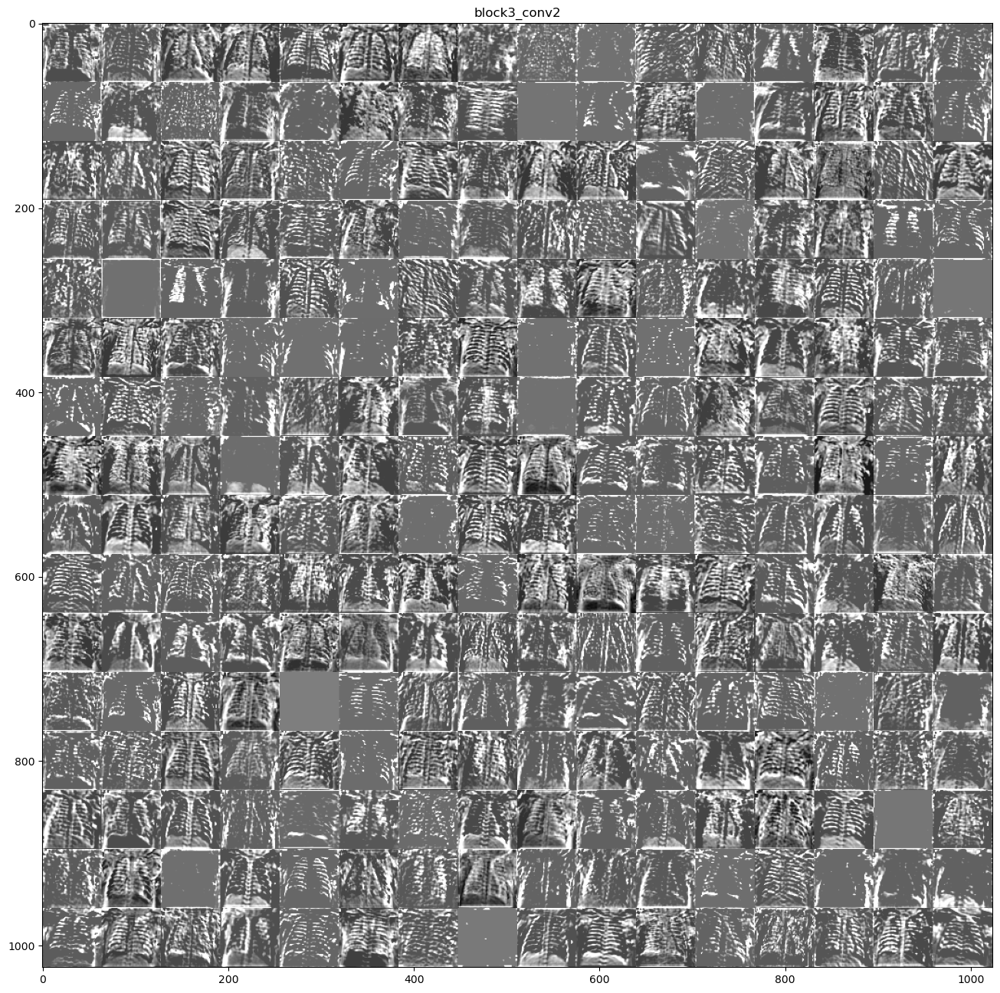

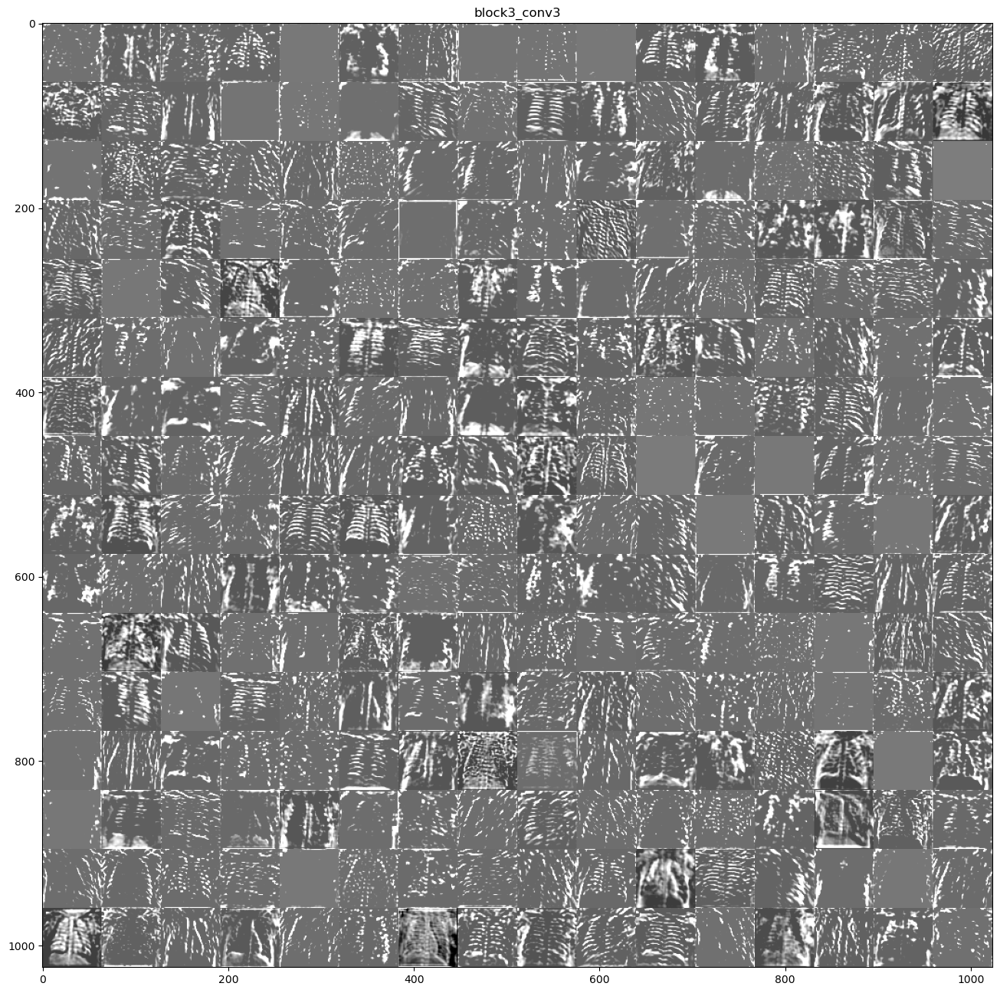

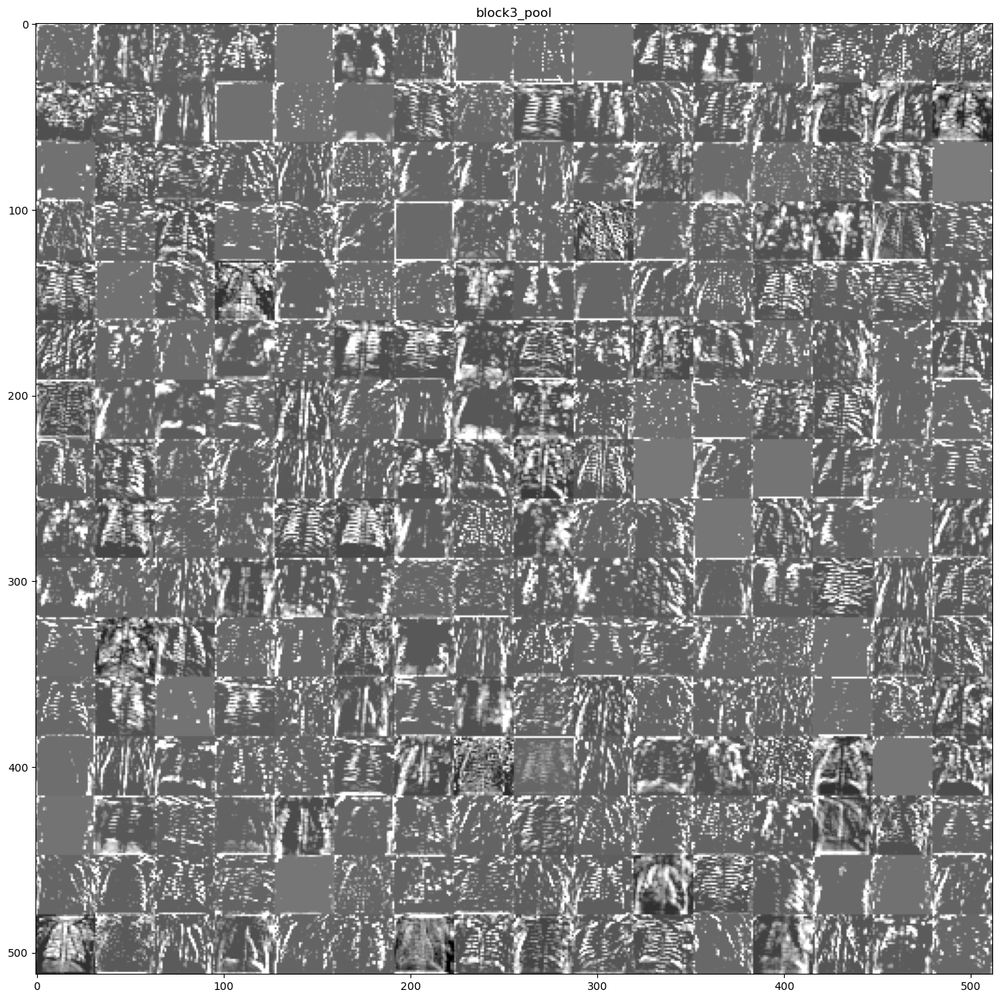

In [20]:
print_intermediate_activations(layer_names, activations, how_many_layers_to_show=10)

# Visualizing convnet filters
Understand which parts of a given image led a convnet to its final classification decision.

## VGG-16

In [196]:
def visual_con_filters (model, layer_name):
    for layer in model.layers:
      if isinstance(layer, (keras.layers.Conv2D, keras.layers.SeparableConv2D)):
        print(layer.name)
        
    layer = model.get_layer(name=layer_name)
    feature_extractor = keras.Model(inputs=model.input, outputs=layer.output)
    
    activation = feature_extractor(
    keras.applications.vgg16.preprocess_input(img_tensor))

In [197]:
visual_con_filters(vgg16_model, "block2_conv1")

block1_conv1
block1_conv2
block2_conv1
block2_conv2
block3_conv1
block3_conv2
block3_conv3
block4_conv1
block4_conv2
block4_conv3
block5_conv1
block5_conv2
block5_conv3


In [198]:
import tensorflow as tf

def compute_loss(image, layer_name, filter_index):
  layer = model.get_layer(name=layer_name)
  feature_extractor = keras.Model(inputs=model.input, outputs=layer.output)
  activation = feature_extractor(image)
  filter_activation = activation[:, 2:-2, 2:-2, filter_index] # avoid border artifacts
  return tf.reduce_mean(filter_activation) # return mean activation values for the filter

In [185]:
def gradient_ascent_step(image, layer_name, filter_index, learning_rate):
    with tf.GradientTape() as tape: # inside the scope, perform some tensor operations
        tape.watch(image) # Explicitly watch the image tensor, since it isn’t a TensorFlow Variable (only Variables are automatically watched in a gradient tape).
        loss = compute_loss(image, layer_name, filter_index) # how much the current image activates the filter.
    # then, outside the scope, retrieve the gradients based on the "recorded" variables
    grads = tape.gradient(loss, image) # Compute the gradients of the loss with respect to the image.
    grads = tf.math.l2_normalize(grads) # gradient normalization trick
    image += learning_rate * grads # Move the image a little bit in a direction that activates our target filter more strongly.
    return image

In [186]:
img_width = 256
img_height = 256

def generate_filter_pattern(layer_name, filter_index):
    iterations = 30
    learning_rate = 10.
    image = tf.random.uniform( # initialize an image tensor with random values in the range centered in 0.5
        minval=0.4,
        maxval=0.6,
        shape=(1, img_width, img_height, 3))
    for i in range(iterations):
        image = gradient_ascent_step(image, layer_name, filter_index, learning_rate)
    return image[0].numpy()

In [187]:
def deprocess_image(image):
    image -= image.mean()
    image /= image.std()
    image *= 64
    image += 128
    image = np.clip(image, 0, 255).astype("uint8")
    image = image[25:-25, 25:-25, :] #avoid border artifacts
    return image

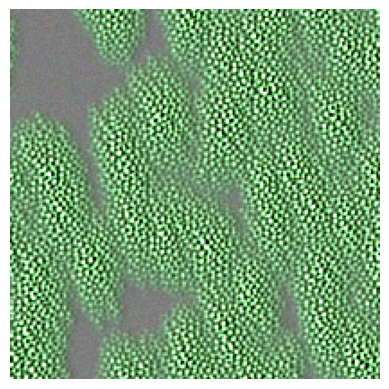

In [181]:
plt.axis("off")
plt.imshow(deprocess_image(generate_filter_pattern("block2_conv1", filter_index=2)))

In [182]:
all_images = []
for filter_index in range(16):
    print(f"Processing filter {filter_index}")
    image = deprocess_image(
        generate_filter_pattern("block2_conv1", filter_index)
    )
    all_images.append(image)

margin = 5
n = 4
cropped_width = img_width - 25 * 2
cropped_height = img_height - 25 * 2
width = n * cropped_width + (n - 1) * margin
height = n * cropped_height + (n - 1) * margin
stitched_filters = np.zeros((width, height, 3))

for i in range(n):
    for j in range(n):
        image = all_images[i * n + j]
        stitched_filters[
            (cropped_width + margin) * i : (cropped_width + margin) * i + cropped_width,
            (cropped_height + margin) * j : (cropped_height + margin) * j
            + cropped_height,
            :,
        ] = image

Processing filter 0
Processing filter 1
Processing filter 2
Processing filter 3
Processing filter 4
Processing filter 5
Processing filter 6
Processing filter 7
Processing filter 8
Processing filter 9
Processing filter 10
Processing filter 11
Processing filter 12
Processing filter 13
Processing filter 14
Processing filter 15


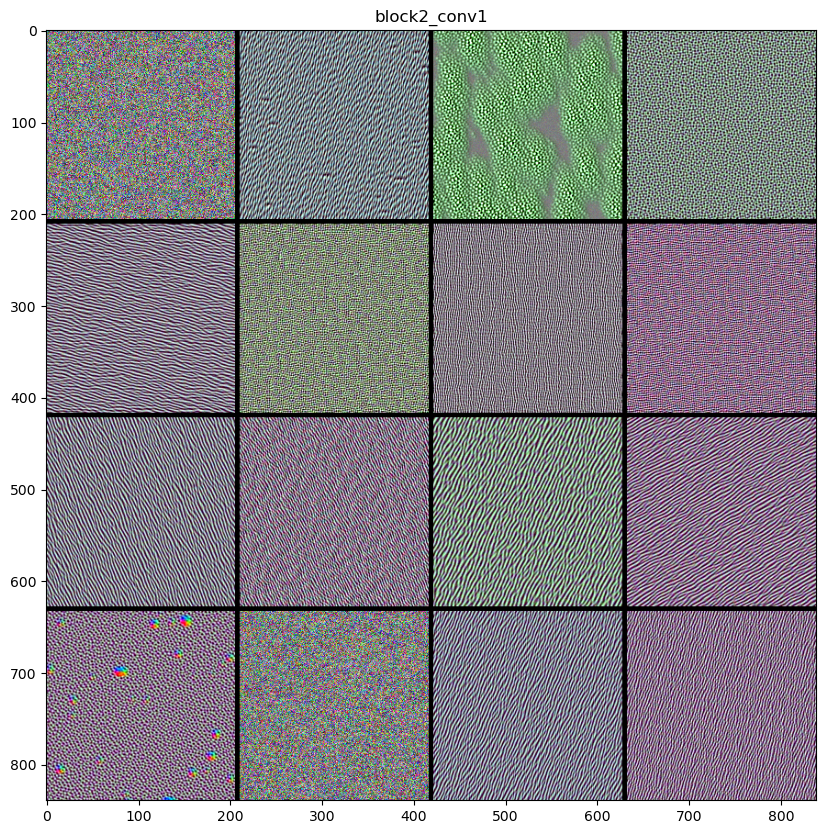

In [172]:
plt.figure(figsize=(10, 10))
plt.title(layer_name)
plt.imshow(stitched_filters.astype("uint8"))
plt.show()

## CNN from scratch

In [180]:
visual_con_filters(cnn_scratch, "conv2d_37")

conv2d_37
conv2d_38
conv2d_39
conv2d_40
conv2d_41


In [191]:
layer_name = "conv2d_37"

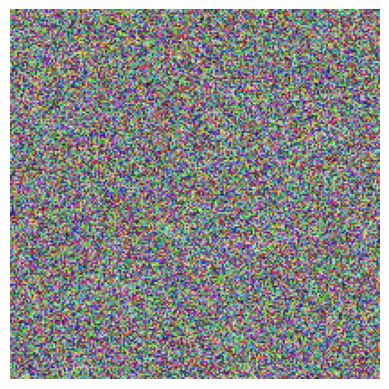

In [192]:
plt.axis("off")
plt.imshow(deprocess_image(generate_filter_pattern("conv2d_37", filter_index=2)))

In [193]:
all_images = []
for filter_index in range(16):
    print(f"Processing filter {filter_index}")
    image = deprocess_image(
        generate_filter_pattern("conv2d_37", filter_index)
    )
    all_images.append(image)

margin = 5
n = 4
cropped_width = img_width - 25 * 2
cropped_height = img_height - 25 * 2
width = n * cropped_width + (n - 1) * margin
height = n * cropped_height + (n - 1) * margin
stitched_filters = np.zeros((width, height, 3))

for i in range(n):
    for j in range(n):
        image = all_images[i * n + j]
        stitched_filters[
            (cropped_width + margin) * i : (cropped_width + margin) * i + cropped_width,
            (cropped_height + margin) * j : (cropped_height + margin) * j
            + cropped_height,
            :,
        ] = image

Processing filter 0
Processing filter 1
Processing filter 2
Processing filter 3
Processing filter 4
Processing filter 5
Processing filter 6
Processing filter 7
Processing filter 8
Processing filter 9
Processing filter 10
Processing filter 11
Processing filter 12
Processing filter 13
Processing filter 14
Processing filter 15


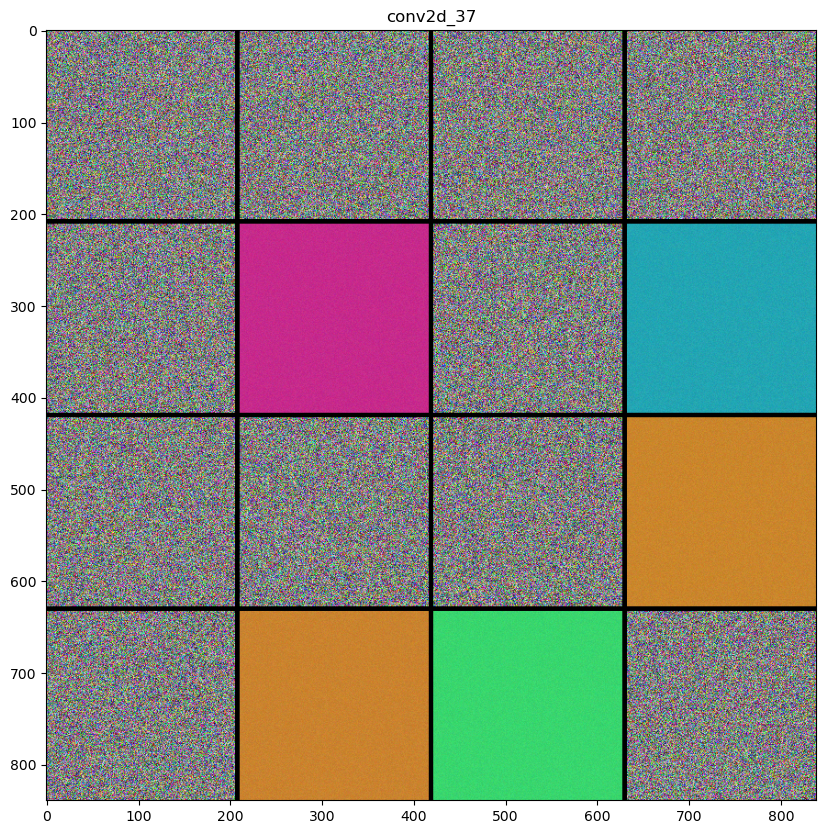

In [194]:
plt.figure(figsize=(10, 10))
plt.title(layer_name)
plt.imshow(stitched_filters.astype("uint8"))
plt.show()

## Visualizing heatmaps of class activation

In [139]:
cnn_scratch = model
grad_cam = []
heat_maps= []

In [140]:
def get_img_array(img_path, target_size):
    img = keras.utils.load_img(img_path, target_size=target_size)
    array = keras.utils.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    array = keras.applications.vgg16.preprocess_input(array)
    return array

img_array = get_img_array(img_path, target_size=(256, 256))

In [176]:
def heatmaps(model, last_conv_layer_name, classifier_layer_names = list()):
    preds = model.predict(img_array)
    
    np.argmax(preds[0])
    
    last_conv_layer= model.get_layer(last_conv_layer_name) #last_conv_layer_name # output shape (x, 10, 10, 2048)
    last_conv_layer_model= keras.Model(model.inputs, last_conv_layer.output)
    
    classifier_input = keras.Input(shape=last_conv_layer.output.shape[1:])
    x = classifier_input
    for layer_name in classifier_layer_names:
        x = model.get_layer(layer_name)(x)
    classifier_model = keras.Model(classifier_input, x)
    
    with tf.GradientTape() as tape:
        last_conv_layer_output = last_conv_layer_model(img_array) # output feature maps of the last conv layer.
        tape.watch(last_conv_layer_output)
        preds = classifier_model(last_conv_layer_output)  
        top_pred_index = tf.argmax(preds[0]) 
        top_class_channel = preds

    grads = tape.gradient(top_class_channel, last_conv_layer_output) # gradient of the pneumonia class with regard to the output feature maps of our last conv layer

    #print(grads.shape)
    
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2)).numpy() # evaluate the mean over the gradient tensor, for each channel separately --> returns a vector of 2048 elements
    #print(pooled_grads.shape)
    weighted_last_conv_layer_output = last_conv_layer_output.numpy()[0]
    for i in range(pooled_grads.shape[-1]):
        weighted_last_conv_layer_output[:, :, i] *= pooled_grads[i]
    
    heatmap = np.mean(weighted_last_conv_layer_output, axis=-1)
    
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)
    #plt.matshow(heatmap)
    
    import matplotlib.cm as cm

    img = keras.utils.load_img(img_path)
    img = keras.utils.img_to_array(img)

    heatmap = np.uint8(255 * heatmap)

    jet = cm.get_cmap("jet")
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    jet_heatmap = keras.utils.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.utils.img_to_array(jet_heatmap)

    superimposed_img = jet_heatmap * 0.4 + img
    superimposed_img = keras.utils.array_to_img(superimposed_img)
    
    grad_cam.append(superimposed_img)
    heat_maps.append(heatmap)
    
    #plt.figure(figsize= (10,10))
    #plt.imshow(superimposed_img)

In [177]:
heatmaps(cnn_scratch, "conv2d_41", [
    "conv2d_41",
    "flatten_8",
])

1/1 [==============================] - 0s 37ms/step


In [178]:
preds = cnn_scratch.predict(img_array)

1/1 [==============================] - 0s 64ms/step


In [179]:
heatmaps(vgg16_model, "block5_conv3", [
    "block5_conv3",
    "block5_pool",
])

1/1 [==============================] - 0s 311ms/step


Text(0.5, 1.0, 'VGG16')

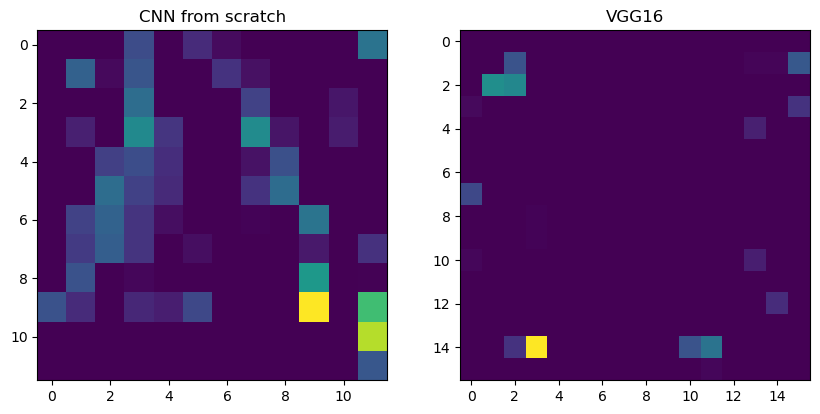

In [150]:
fig = plt.figure(figsize=(10, 10))

fig.add_subplot(2, 2, 1)
plt.imshow(heat_maps[0])
plt.title("CNN from scratch")

fig.add_subplot(2, 2, 2)
plt.imshow(heat_maps[1])
plt.title("VGG16")

#fig.add_subplot(2, 2, 3)
#plt.imshow(heatmap_resnet)
#plt.title("ResNet-50 first model")

#fig.add_subplot(2, 2, 4)
#plt.imshow(heatmap_resnet_2)
#plt.title("ResNet-50 second model")

Text(0.5, 1.0, 'VGG16')

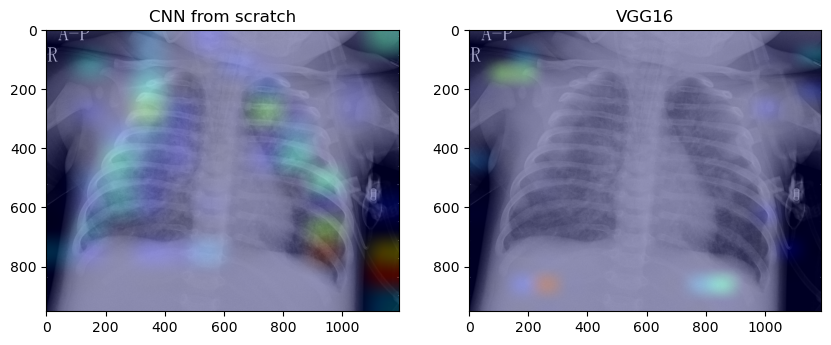

In [151]:
fig = plt.figure(figsize=(10, 10))

fig.add_subplot(2, 2, 1)
plt.imshow(grad_cam[0])
plt.title("CNN from scratch")

fig.add_subplot(2, 2, 2)
plt.imshow(grad_cam[1])
plt.title("VGG16")